# CVPR Project

## Multi Model Fitting images

Iva Ilcheva<br>
Reinard Lazuardi Kuwandy

In [254]:
import cv2 as cv
import matplotlib.pyplot as plt
import numpy as np
import random
import math
from scipy import spatial
%matplotlib inline

IMG_TARGET = 'img/target-chocolates.jpg'
IMG_TEMPLATE = [
    'img/au-lait.jpg',
    'img/choco-noisettes.jpg', 
    'img/cremant.jpg', 
    'img/noir-amarante.jpg',
    'img/noir-coco.jpg',
    'img/noir-gingembre.jpg', 
    'img/noir-orange.jpg'
]

### Helper Functions

In [145]:
'''
    Read images.
'''
def read_images(img_path1, img_path2):
    img1 = cv.imread(img_path1)  
    img2 = cv.imread(img_path2) 
    
    return img1, img2  

In [146]:
'''
    Plot images.
'''
def plot_images(img_1, img_2):
    fx, plots = plt.subplots(1, 2, figsize=(20,10))
    plots[0].set_title("Target Image")
    plots[0].imshow(img_1)

    plots[1].set_title("Template Image")
    plots[1].imshow(img_2)

In [147]:
'''
    Find keypoints and descriptors with SIFT.
'''
def sift_keypoints_and_descriptors(img_1, img_2):
    sift = cv.xfeatures2d.SIFT_create()
    keypoints_1, descriptors_1 = sift.detectAndCompute(img_1,None)
    keypoints_2, descriptors_2 = sift.detectAndCompute(img_2,None)
    
    return keypoints_1, descriptors_1, keypoints_2, descriptors_2

In [148]:
'''
    Find keypoints and descriptors with KAZE.
'''
def kaze_keypoints_and_descriptors(img_1, img_2):
    
    gray1 = cv.cvtColor(img_1, cv.COLOR_BGR2GRAY)
    gray2 = cv.cvtColor(img_2, cv.COLOR_BGR2GRAY)    

    detector = cv.AKAZE_create()
    
    keypoints_1, descriptors_1 = detector.detectAndCompute(gray1, None)
    keypoints_2, descriptors_2 = detector.detectAndCompute(gray2, None)
    
    return  keypoints_1, descriptors_1, keypoints_2, descriptors_2

In [149]:
'''
    Find closest matches based on distance.
'''
#cv.NORM_HAMMING for kaze
def get_best_matches(descriptors_1, desriptors_2, ratio, method=cv.NORM_L1):
    bf = cv.BFMatcher(cv.NORM_L1, crossCheck = False)
    matches = bf.knnMatch(descriptors_1,desriptors_2,k=2)

    best_matches_1 = []
    plot_best_matches_1 = []

    for m,n in matches:
        if m.distance < ratio*n.distance:
            plot_best_matches_1.append([m])
            best_matches_1.append(m)
    
    return plot_best_matches_1, best_matches_1

In [150]:
'''
    Draw closest matches.
'''
def draw_closest_matches(img_1, img_2, keypoints_1, keypoints_2, plot_best_matches_1):
    img = cv.drawMatchesKnn(img_1,keypoints_1,img_2,keypoints_2,plot_best_matches_1,None,flags=cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.figure(figsize = (200,200))
    plt.imshow(img)
    plt.show()

In [151]:
'''
    Retrieve matching point correspondences' coordinates
    for each of the images.
'''
def get_correspondences(best_matches_1, keypoints_1, keypoints_2):
    
    correspondences_1 = []
    good = []
    
    for match in best_matches_1:

        img1_idx = match.queryIdx
        img2_idx = match.trainIdx

        (x1, y1) = keypoints_1[img1_idx].pt
        (x2, y2) = keypoints_2[img2_idx].pt

        correspondences_1.append([x2, y2, x1, y1])
        
    return correspondences_1

In [152]:
'''
    Function to estimate the error:
        || pH - p' ||
'''

def euclidean_distance(correspondence, homographyMatrix):
    
    actualP = np.transpose([correspondence[0], correspondence[1], 1])
    actualPPrime = np.transpose([correspondence[2], correspondence[3], 1])
    
    estimatedPPrime = np.dot(homographyMatrix, actualP)
    estimatedPPrime = estimatedPPrime/estimatedPPrime[2]

    error = np.linalg.norm(actualPPrime - estimatedPPrime)

    return error

In [153]:
'''
    Function to estimate the homography matrix H.
'''
def estimate_homography(correspondences):
    A = []
    
    for cor in correspondences:
        p1 = [cor[0], cor[1], 1]
        p2 = [cor[2], cor[3], 1]

        A.append([-p2[2] * p1[0], -p2[2] * p1[1], -p2[2] * p1[2], 0, 0, 0, p2[0] * p1[0], p2[0] * p1[1], p2[0] * p1[2]])
        A.append([0, 0, 0, -p2[2] * p1[0], -p2[2] * p1[1], -p2[2] * p1[2], p2[1] * p1[0], p2[1] * p1[1], p2[1] * p1[2]])

    U, diagonalMatrix, Vt = np.linalg.svd(A)

    homographyMatrix = (Vt[-1]/Vt[-1][-1]).reshape((3,3))  

    return homographyMatrix, diagonalMatrix

In [154]:
'''
    Function to compute new Loop Number
'''
def compute_loop_number(sample_size, confidence, point_num, inlier_num):
    num = int(math.ceil(math.log10(1 - 0.01 * confidence) / math.log10(1 - float(inlier_num/point_num)**sample_size)))
    return num

In [155]:
'''
    Function to estimate a model via MSAC.
'''
def msac(point_correspondences, threshold=0.9, confidence=99, num_trials=1000, sample_size=4, ransac_threshold=5):
    num_pts = len(point_correspondences)
    max_dis = num_pts * threshold
    best_dis = max_dis
    best_residual = []
    H = None
    idx_trial = 1
    
    while idx_trial <= num_trials:
        
        '''
            Pick minimum set of 4 point correspondences
            and estimate a model.
        '''
        random_four_indices = random.sample(range(0, num_pts), sample_size)
        random_four = [point_correspondences[i] for i in random_four_indices]

        
        ''' 
            Estimate homography matrix H,
            based on 4 picked points.
        '''
        current_H, _ = estimate_homography(np.vstack(random_four))
        
        
        '''
            Find inliers within Euclidean distance of threshold.
        '''
        inliers = []
        acc_dis = 0
        idx_pt = 1
        while (acc_dis < best_dis) and (idx_pt < num_pts):
            distance = euclidean_distance(point_correspondences[idx_pt], current_H)
            dis = min(distance, threshold)
            if distance < ransac_threshold:
                inliers.append(point_correspondences[idx_pt])
            
            acc_dis = acc_dis + dis
            idx_pt = idx_pt + 1

        ''' 
            Always update current model,
            when a better one with more inliers
            is available.
        '''
        if acc_dis < best_dis:
            max_inliers = inliers
            best_dis = acc_dis
            H = current_H
            inlier_num = num_pts - best_dis / threshold;
            num = compute_loop_number(sample_size, confidence, num_pts, inlier_num)
            num_trials = min(num_trials, num)

        idx_trial = idx_trial + 1
        
    return H, max_inliers

In [156]:
'''
    Function to estimate all models until #min_correspondences (used for estimation) is reached.
'''
def sequential_msac(correspondences, threshold, min_correspondences_count,confidence=99,num_trials=1000, ransac_threshold=5):
    
    models = []
    inliers = []
    epochs = 0
    while (len(correspondences) > min_correspondences_count):
        H, inliers = msac(correspondences, threshold, confidence, num_trials,min_correspondences_count, ransac_threshold)
        if len(inliers)/len(correspondences) > 0.05:
            models.append([H, inliers])
            correspondences = [i for i in correspondences if i not in inliers]
            print(len(correspondences))
            if len(correspondences) < min_correspondences_count:
                break
            epochs = 0
        else:
            if epochs == len(correspondences):
                models.append([H, inliers])
                break
            else:
                epochs += 1
    return models

In [198]:
'''
    Function to estimate all models until #min_correspondences (used for estimation) is reached.
'''
def plot_image_correspondences(img_target_plot, img_template_plot, models):
    
    inliers1 = []
    inliers2 = []

    fx, plots = plt.subplots(1, 2, figsize=(20,10))
    plots[0].set_title("Target Image")
    plots[1].set_title("Template Image")

    h,w = cv.cvtColor(img_template_plot, cv.COLOR_BGR2GRAY).shape
    pts = np.float32([[0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)

    # Blue color in BGR 
    color = (255, 255, 255)

    # Line thickness of 2 px 
    thickness = 25

    for model in models:
        dst = cv.perspectiveTransform(pts,model[0])
        img_target_plot = cv.polylines(img_target_plot,[np.int32(dst)],True,color,3, cv.LINE_AA,)
        for inlier in model[1]:
            inliers1.append([inlier[2],inlier[3]])
            inliers2.append([inlier[0],inlier[1]])
            plots[1].scatter(*zip(*inliers2), color='red')
            plots[0].scatter(*zip(*inliers1), color='red')

    plots[0].imshow(img_target_plot)
    plots[1].imshow(img_template_plot)

In [234]:
'''
    Function to draw the bounding boxes
'''
def draw_bounding_boxes(img_target_plot, img_template_plot, models, scale_factor=1, isPostJLinkage=False):
    
    inliers1 = []
    inliers2 = []

    plt.figure(figsize=(50,25))
    plt.title("All objects identified")


    h,w = cv.cvtColor(img_template_plot, cv.COLOR_BGR2GRAY).shape
    pts = np.float32([[0,0],[0,h-1],[w-1,h-1],[w-1,0] ]).reshape(-1,1,2)

    color = (255, 255, 255)

    thickness = 50

    for model in models:
        if isPostJLinkage:
            H,_ = estimate_homography(np.vstack(model))
        else:
            H = model[0]
        H = scale_homography(H, scale_factor)
        dst = cv.perspectiveTransform(pts,H)
        img_target_plot = cv.polylines(img_target_plot,[np.int32(dst)],True,color,3, cv.LINE_AA)
    
    

    plt.imshow(img_target_plot)

In [202]:
''' 
    Function to scale homography
'''
def scale_homography(H, scale_factor):
    return H @ [[scale_factor, 0, 0], [0, scale_factor, 0], [0, 0, 1]]

In [158]:
'''
    Function to compute preference sets
'''
def get_preference_sets(correspondences, models):
    CORRESPONDENCES = 1
    BELONGS = 1
    NOT_BELONGS = 0
    
    PS = []
    for c in correspondences:
        point_PS = []
        for m in models:
            if c in m[CORRESPONDENCES]:
                point_PS.append(BELONGS)
            else:
                point_PS.append(NOT_BELONGS)
        PS.append(point_PS)
        
    return PS

In [159]:
'''
    Function to plot Preference Sets
'''
def plot_scatter(PS):
    N = np.where(np.array(PS) == 1)
    x = N[1]
    y = N[0]

    plt.scatter(x, y)
    plt.title('Preference Sets')
    plt.xlabel('Models')
    plt.ylabel('Points')
    plt.show()

In [160]:
'''
    Function to find the union of 2 points
'''
def get_union(point1, point2):
    point1 = np.asarray(point1, np.bool)
    point2 = np.asarray(point2, np.bool)
    return np.double(np.bitwise_or(point1, point2))

In [161]:
'''
    Function to calculate jaccard distance
'''
def get_jaccard_distance(point_1, point_2):
    point_1 = np.asarray(point_1, np.bool)
    point_2 = np.asarray(point_2, np.bool)
    return 1 - (np.double(np.bitwise_and(point_1, point_2).sum()) / get_union(point_1, point_2).sum())

In [162]:
'''
    Function to create initial clusters
'''
def initial_clusters(preference_sets):
    clusters = []
    for i in range(0,len(preference_sets)):
        cluster = [preference_sets[i],i]
        clusters.append(cluster)
    return clusters

In [163]:
'''
    J-Linkage implementation
'''
def j_linkage(preference_sets):
    clusters = initial_clusters(preference_sets)
    min_jaccard_distance = 0.0
    index_1 = 0
    index_2 = 0

    while True:
        jaccard_distances = []
        for i in range(0, len(clusters)):
            jaccard_distances_for_i = []
            for j in range(0, len(clusters)):
                if i == j:
                    jaccard_distances_for_i.append(1.0)
                else:
                    jaccard_distances_for_i.append(get_jaccard_distance(clusters[i][0], clusters[j][0]))
            jaccard_distances.append(jaccard_distances_for_i)

        min_jaccard_distance = np.nanmin(jaccard_distances)

        
        if min_jaccard_distance != 1.0:

            (index_1, index_2) = np.unravel_index(np.array(jaccard_distances).argmin(), np.array(jaccard_distances).shape)
            clusters[index_1][0] = get_union(clusters[index_1][0],clusters[index_2][0])
            clusters[index_1] += clusters[index_2][1:]
            del clusters[index_2]
        else:
            break
     
        
    return clusters

In [164]:
'''
    Remove the preference set from the cluster after j_linkage is performed.
'''
def remove_pref_set(cl):
    for i in cl:
        del i[0] 
    return cl

In [165]:
'''
    Function to get model from cluster.
'''
def get_model(cl,correspondences1):
    mod = []
    for clust in cl:
        m = []
        for ind in range(0,len(correspondences1)):
            if ind in clust:
                m.append(correspondences1[ind])
        mod.append(m)
    return mod

In [166]:
'''
    Function to delete outliers with a small number cluster,
    we cannot compute homography matrix from.
'''
def delete_small_model(mod, min_num=4):
    new_mod = []
    for m in range(0,len(mod)):
        if len(mod[m]) > min_num:
            new_mod.append(mod[m])
    
    return new_mod

In [248]:
'''
    Function to define clusters in order to calculate the diameter of cluster.
'''
def define_clusters(cluster_model):
    clusters_ = []
    clusters_size_list = []
    for each in cluster_model:
        cluster = []
        for i in each:
            cluster.append([i[2], i[3]])
        clusters_size_list.append(len(cluster))
        clusters_.append(np.array(cluster))
    return clusters_,  np.array(clusters_size_list)

In [255]:
'''
    Function to compute the diameter based on convex hull. 
'''
def diameter(pts):
    # We need at least 3 points to construct the convex hull
    if pts.shape[0] <= 1:
        return 0
    if pts.shape[0] == 2:
        return ((pts[0] - pts[1])**2).sum()
    # The two points which are fruthest apart will occur as vertices of the convex hull
    hull = spatial.ConvexHull(pts)
    candidates = pts[spatial.ConvexHull(pts).vertices]
    return spatial.distance_matrix(candidates, candidates).max()


'''
    Function to compute dunn index.
    The higher the index is, the better the clustering.
'''
def dunn_index(clusters_size_list, clusters_):
    max_intracluster_dist = max(diameter(clusters_[i]) for i in range(len(clusters_)))
    min_intercluster_dist = clusters_size_list.min()
    return min_intercluster_dist / max_intracluster_dist

In [281]:
'''
    Function to remove unfit clusters based on 
    comparison of mean diameter of all clusters and diameter inside of 
    particular cluster.
'''
from statistics import median
def remove_far_distances_clusters(clusters_, new_models_, min_distance=100):
    list_candidates = []
    new_test_model = []
    list_dist_per_cluster = []
    mean_distance = 0
    
    ## Calculate the mean diameter of all cluters 
    ## (Idea: the matching points in target image shouldn't be far away from each other for each cluster)
    all_diameter_cluster = [diameter(clusters_[i]) for i in range(len(clusters_))]
    print(all_diameter_cluster)
    AVG = sum(all_diameter_cluster) / len(all_diameter_cluster)
    MEDIAN = median(all_diameter_cluster)
    
    for k,cluster_ in enumerate(clusters_):
        candidates = cluster_[spatial.ConvexHull(cluster_).vertices]
        dist_mat = spatial.distance_matrix(candidates, candidates)
    
        # get indices of candidates that are furthest apart
        i, j = np.unravel_index(dist_mat.argmax(), dist_mat.shape)

        dist = math.sqrt((candidates[j][0]-candidates[i][0])**2 + (candidates[j][1]-candidates[i][1])**2)
        list_dist_per_cluster.append(dist)
    
    for k, each_cluster_dist in enumerate(list_dist_per_cluster):
        if each_cluster_dist < MEDIAN:
            new_test_model.append(new_models_[k])
            
            
    return new_test_model

### Implementation

In [237]:
img_target, img_template = read_images(IMG_TARGET, IMG_TEMPLATE[0])

In [168]:
img_template2, img_template3 = read_images(IMG_TEMPLATE[1], IMG_TEMPLATE[2])

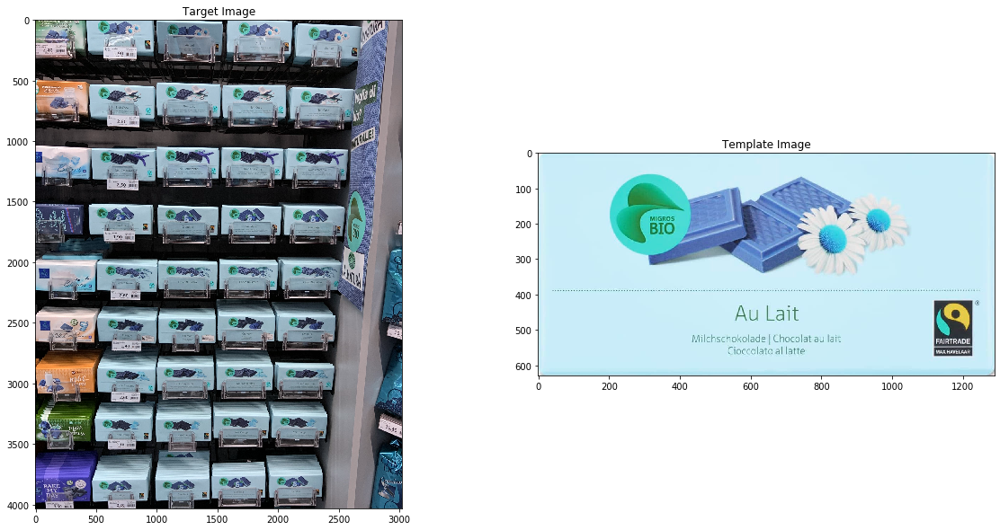

In [169]:
plot_images(img_target, img_template)

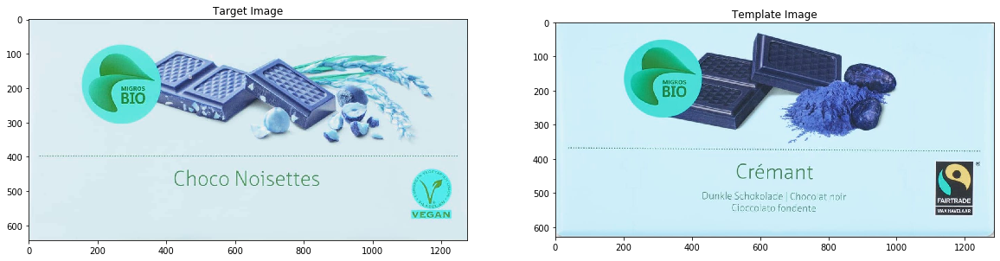

In [170]:
plot_images(img_template2, img_template3)

In [171]:
keypoints_target, descriptors_target, keypoints_template1, descriptors_template1 = sift_keypoints_and_descriptors(img_target, img_template)

In [104]:
keypoints_template2, descriptors_template2, keypoints_template3, descriptors_template3 = sift_keypoints_and_descriptors(img_template2, img_template3)

In [191]:
plot_best_matches1, best_matches1 = get_best_matches(descriptors_target, descriptors_template1, ratio=0.45)

In [192]:
draw_closest_matches(img_target, img_template, keypoints_target, keypoints_template1, plot_best_matches1)

In [193]:
correspondences1 = get_correspondences(best_matches1, keypoints_target, keypoints_template1)

In [235]:
models1 = sequential_msac(correspondences1, 1, 4,99,2500, 0.8)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: divide by zero encountered in true_divide
  if sys.path[0] == '':
/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:12: RuntimeWarning: invalid value encountered in true_divide
  if sys.path[0] == '':


178
164
153
145
137
130
121
113
107
101
94
89
84
79
74
70
66
62
57
53
49
44
40
36
32
28
24
20
16
12
8
4


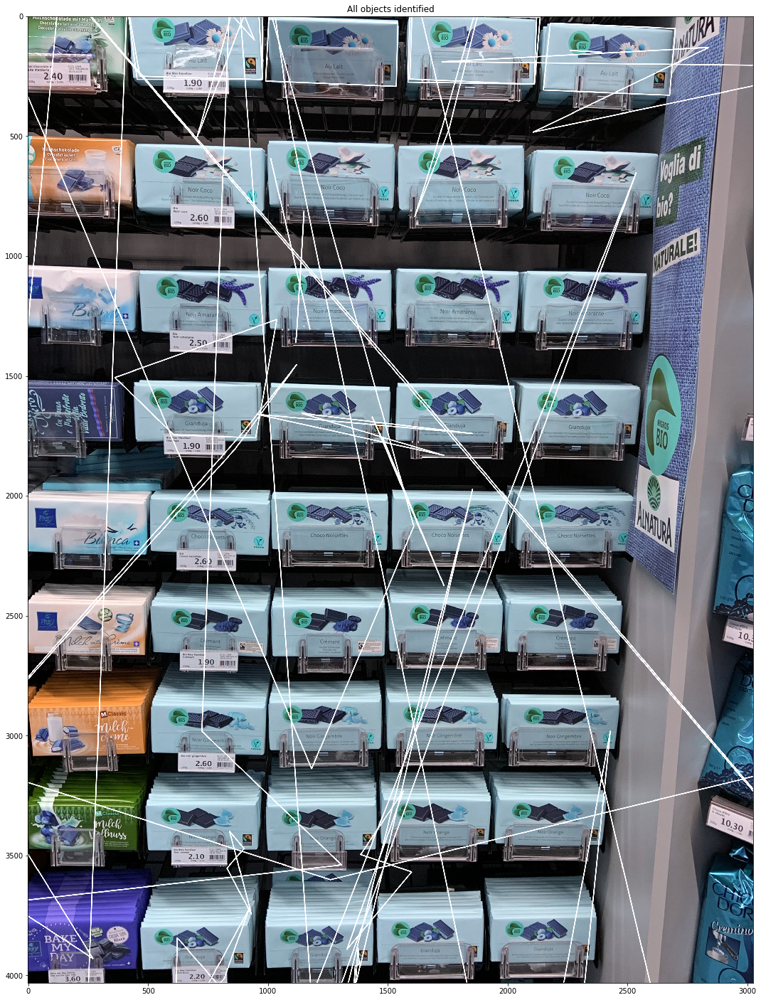

In [238]:
draw_bounding_boxes(img_target, img_template, models1, 1, isPostJLinkage=False)

In [239]:
PS = get_preference_sets(correspondences1, models1)

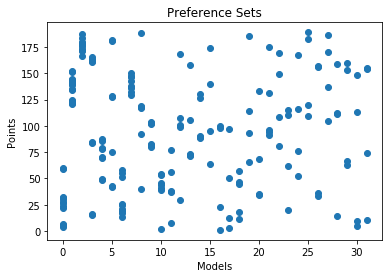

In [240]:
plot_scatter(PS)

In [241]:
cl = j_linkage(PS)

/Library/Frameworks/Python.framework/Versions/3.7/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: invalid value encountered in double_scalars
  import sys


In [263]:
cl

[[0, 61, 65, 163],
 [1, 23, 98, 100],
 [2, 39, 41, 44, 46, 53, 54],
 [3, 12, 50, 97],
 [4, 6, 7, 22, 24, 27, 28, 30, 31, 32, 59, 60],
 [5, 9, 113, 148],
 [8, 37, 38, 56, 77],
 [10, 74, 154, 155],
 [11, 18, 45, 47, 57],
 [13, 17, 19, 21, 25, 26, 51, 55, 58],
 [14, 111, 112, 159],
 [15, 16, 84, 85, 161, 162, 164, 165],
 [20, 62, 110, 115],
 [29, 99, 101, 107, 168],
 [33, 36, 156, 157],
 [34, 35, 68, 133],
 [40, 92, 117, 118, 119, 188],
 [42, 43, 75, 127, 128, 181, 182],
 [48, 49, 69, 70, 78, 79, 86, 87],
 [52, 76, 116, 167],
 [63, 67, 153, 160],
 [64, 95, 140, 174],
 [66, 93, 114, 185],
 [71, 72, 73, 106, 158],
 [80, 82, 83, 102, 103, 104],
 [81, 108, 149, 169],
 [88, 89, 90, 126, 130],
 [91, 94, 96, 131, 175],
 [105, 137, 170, 186],
 [109, 120, 183, 189],
 [121, 122, 123, 124, 125, 134, 135, 139, 141, 142, 144, 145, 151, 152],
 [129, 132, 136, 138, 143, 146, 147, 150],
 [166, 171, 172, 173, 176, 177, 178, 179, 180, 184, 187]]

In [243]:
mod = remove_pref_set(cl)

In [282]:
mod = get_model(cl,correspondences1)

In [283]:
new_mod = delete_small_model(mod, 4)

In [284]:
img_target, img_template = read_images(IMG_TARGET, IMG_TEMPLATE[0])

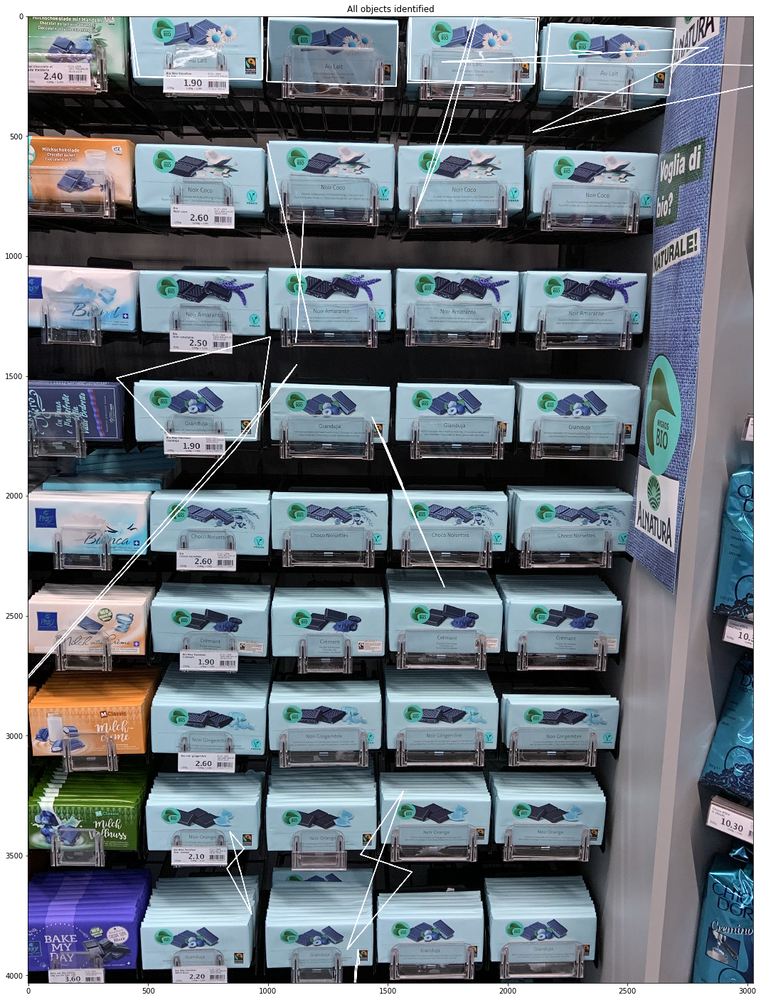

In [285]:
draw_bounding_boxes(img_target, img_template, new_mod, 1, True)

In [286]:
clusters_, clusters_size_list = define_clusters(new_mod)
clusters_size = len(clusters_)
print("Previous dunn index of the cluster : {}".format(dunn_index(clusters_size_list, clusters_)))

new_test_model = remove_far_distances_clusters(clusters_, new_mod,100)

print("Num of clusters previously: {}".format(len(new_mod)))
print("Num of clusters currently: {}".format(len(new_test_model)))

clusters_new, clusters_size_list_new = define_clusters(new_test_model)
print("Current dunn index of the cluster : {}".format(dunn_index(clusters_size_list, clusters_)))

Previous dunn index of the cluster : 0.0012921120412608873
[387.3209887427558, 406.0960288627853, 1689.7940095804813, 3360.2710907089745, 354.03934136203594, 1705.701820069384, 2189.095387373035, 3834.043870151764, 2266.226485065766, 3832.024214365084, 1866.6506111594922, 313.9830324184647, 3869.6334685657976, 3498.7523981792338, 401.7573023841078, 306.4367921027065, 347.30379420478954]
Num of clusters previously: 17
Num of clusters currently: 8
Current dunn index of the cluster : 0.0012921120412608873


In [279]:
img_target, img_template = read_images(IMG_TARGET, IMG_TEMPLATE[0])

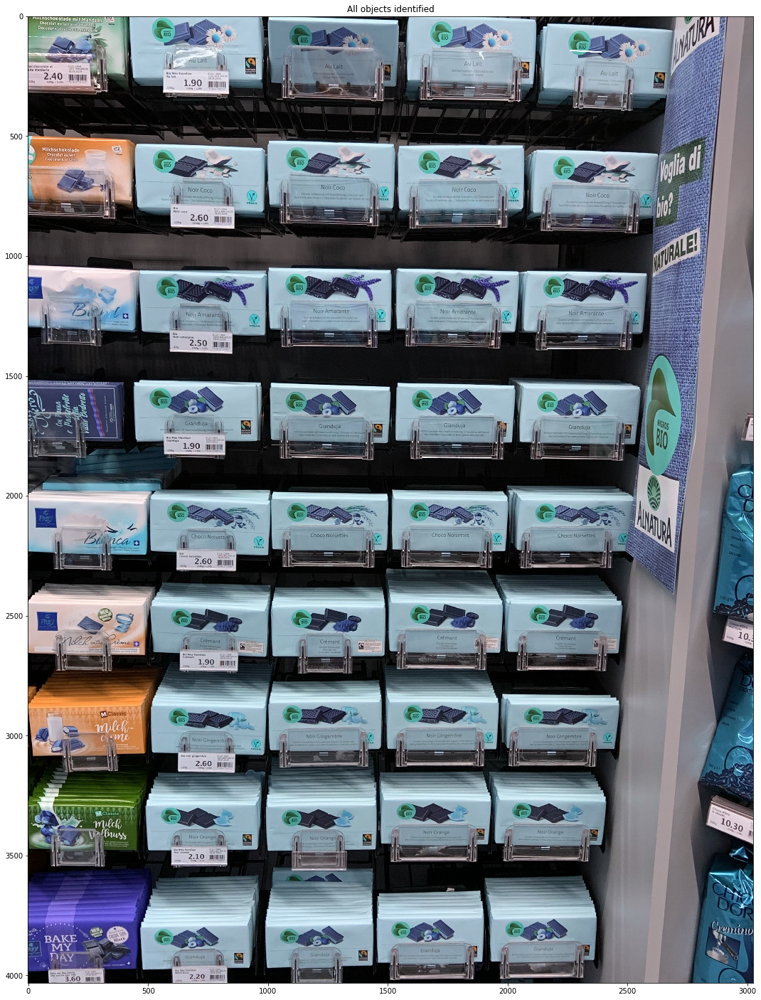

In [280]:
draw_bounding_boxes(img_target, img_template, new_test_model, 1, isPostJLinkage=True)